# Initial cuGraph & graph_tool exploration
Experiments with cuGraph force atlas 2 algorithm and graph visualisation with graph_tools.
We want to move away from Gephi which was used so far. The reason is that Gephi is CPU bound, whereas cuGraph can leverage the GPU.

We render 3 graph of increasing sizes (The graphs have: 197 11.308 508.083 nodes nodes respectively after preprocessing).

# Results
The small and the medium graph render without issues.
The largest graph had parts of it out of the canvas.
Regardless of how we tweaked arguments for the force atlas algo or the draw_graph, it kept having parts out of canvas.

We realised that those out-of-canvas parts were loop-edges of a single node.

In [1]:
import cugraph
import cudf
import pandas as pd
import numpy as np
import time, random

from graph_tool.all import *

def make_gpu_frame(data):
    '''
    given data it makes a cuGraph gpu frame which is similar to a pandas frame
    '''
    # create mapping from address to vertex id
    column_values = data[["source", "target"]].values.ravel()
    unique_values = pd.unique(column_values)
    mapping = pd.DataFrame(unique_values).reset_index().rename(columns = {"index":"vertex",0:"address"} )
    data_ids = data.merge(mapping.rename(columns={"address":"source"})).rename(columns = {"vertex":"source_id"})
    data_ids = data_ids.merge(mapping.rename(columns={"address":"target"})).rename(columns = {"vertex":"target_id"})
    data_ids = data_ids[["source_id", "target_id"]]
    data_ids = cudf.DataFrame.from_pandas(data_ids)
    graph = cugraph.Graph()
    graph.from_cudf_edgelist(data_ids, source='source_id', destination='target_id')
    return graph

def make_cuGraph_layout(graph):
    '''
   A layout is a pd frame like below:
   
                  x         y  vertex
        0  0.463815 -0.143211      29
        1 -0.549100 -5.686268     139
        2 -6.020377 -1.174636     186
        3 -1.020328  3.608905      73
        4 -5.511849  2.750963     123
    '''
    
    layout = cugraph.layout.force_atlas2(graph, max_iter=500,
                                     strong_gravity_mode=True,
                                     barnes_hut_theta=1.2,
                                     outbound_attraction_distribution=False,
                                     gravity=1,
                                     scaling_ratio=1)
    layout = layout.to_pandas()
    return layout

def get_interest_points(layout):
    '''
    center, top-left etc..
    '''
    mean_x = layout['x'].mean()
    mean_y = layout['y'].mean()
    
    max_x = layout['x'].max()
    min_x = layout['x'].min()
    max_y = layout['y'].max()
    min_y = layout['y'].min()

    std_x = layout['x'].std()
    std_y = layout['y'].std()

    return {'center':(mean_x, mean_y), 
            'tl': (min_x, max_y), 
            'tr': (max_x, max_y), 
            'bl': (min_x, min_y), 
            'br': (max_x, min_y)
           }

def convert_to_graph_tool_graph(layout, data=pd.DataFrame({'A' : []})):
    '''
    Takes a layout and gives the info needed to render the graph with graph tool
    '''
    g = Graph(directed=True)

    # take the layout from cugraph and convert it to a graph-tool vertex property
    vprop_double = g.new_vertex_property("vector<double>")
    for i, row in enumerate(layout.sort_values("vertex")[["x", "y"]].values):
        vprop_double[i] = row
      
    if not data.empty:
        eweight = g.new_edge_property("string")
        g.add_edge_list(data[["source", "target", "amount"]].values, hashed=True, eprops=[eweight])

        # create an edge property representing edge width
        esize = g.new_edge_property("float")
        esize.a = list(map(lambda x: float(x), list(eweight)))
        esize.a = (esize.a / (esize.a.max() / 1000.0))
        esize.a = np.sqrt(esize.a)
    else:
        esize = None

    # create a degree map for different vertex sizes based on vertex degree
    deg = g.degree_property_map("in")
    deg.a = 4 * (np.sqrt(deg.a) * 0.1 + 0.4)
        
    return {'graph': g, 
            'deg': deg,
            'pos':vprop_double,
            'esize':esize}

def draw(graph_data, size=500, zoom=1):
    '''
    Graph tool rendering
    '''
    graph_draw(graph_data['graph'],
           pos=graph_data['pos'],
           bg_color=[0,0,0,1],
           vertex_size=graph_data['deg'],
           vertex_fill_color=[1,1,1,1],
           edge_color=[1,1,1,0.5],
           edge_pen_width=graph_data['esize'],
           #output="./img/test.png",
           output_size=[size, size],
           fit_view=zoom)

In [2]:
# Loading the data
small_data = pd.read_csv("./networks/small.csv", dtype={'amount': object})
medium_data = pd.read_csv("./networks/medium.csv", dtype={'amount': object})
big_data = pd.read_csv("./networks/large.csv", dtype={'amount': object})

In [3]:
# Converting raw data to cuGraph frames
small_gpu_frame = make_gpu_frame(small_data)
medium_gpu_frame = make_gpu_frame(medium_data)
big_gpu_frame = make_gpu_frame(big_data)

In [4]:
# Running cuGraph force atlas 2 to generate (x,y) pairs for each node
small_layout = make_cuGraph_layout(small_gpu_frame)
medium_layout = make_cuGraph_layout(medium_gpu_frame)
big_layout = make_cuGraph_layout(big_gpu_frame)
print("The graphs have: " + str(len(small_layout)) + " " + str(len(medium_layout)) + " " + str(len(big_layout)) + " nodes")

The graphs have: 197 11308 508083 nodes


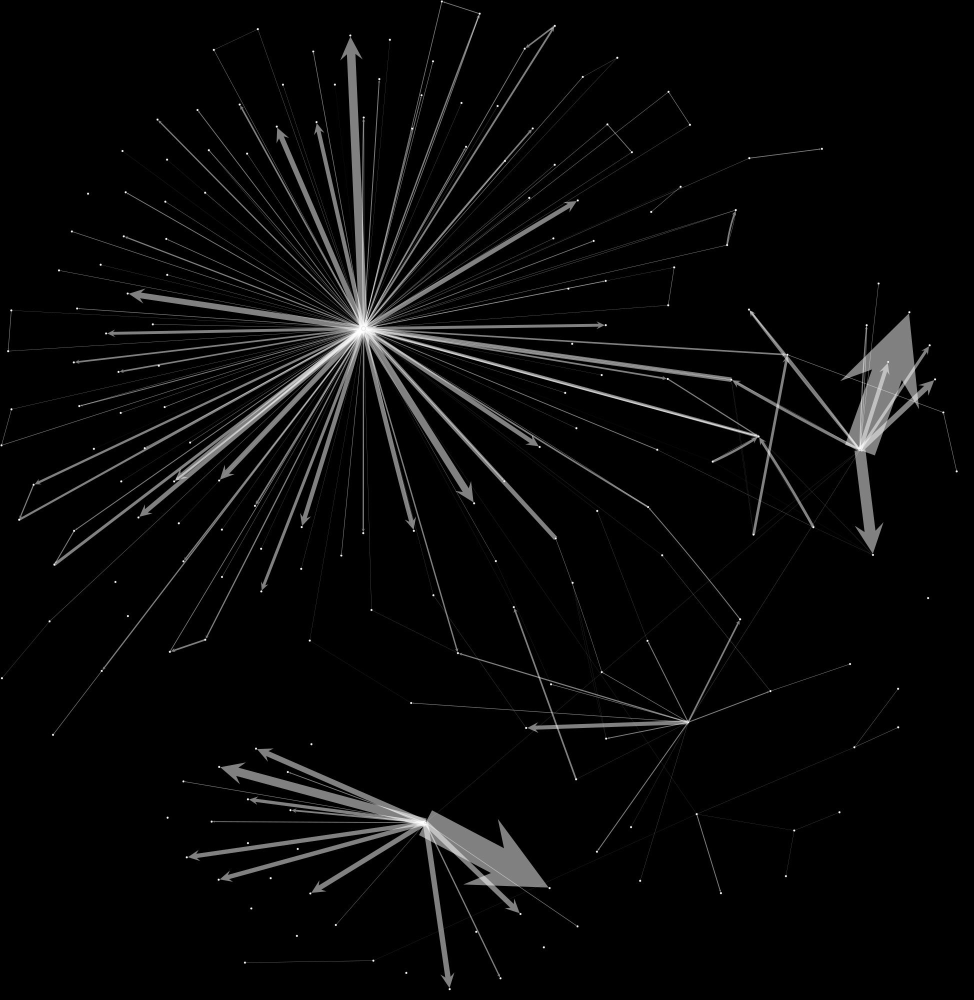

In [6]:
# Rendering the small graph
small = convert_to_graph_tool_graph(small_layout, small_data)
draw(small, size=1000, zoom=1)

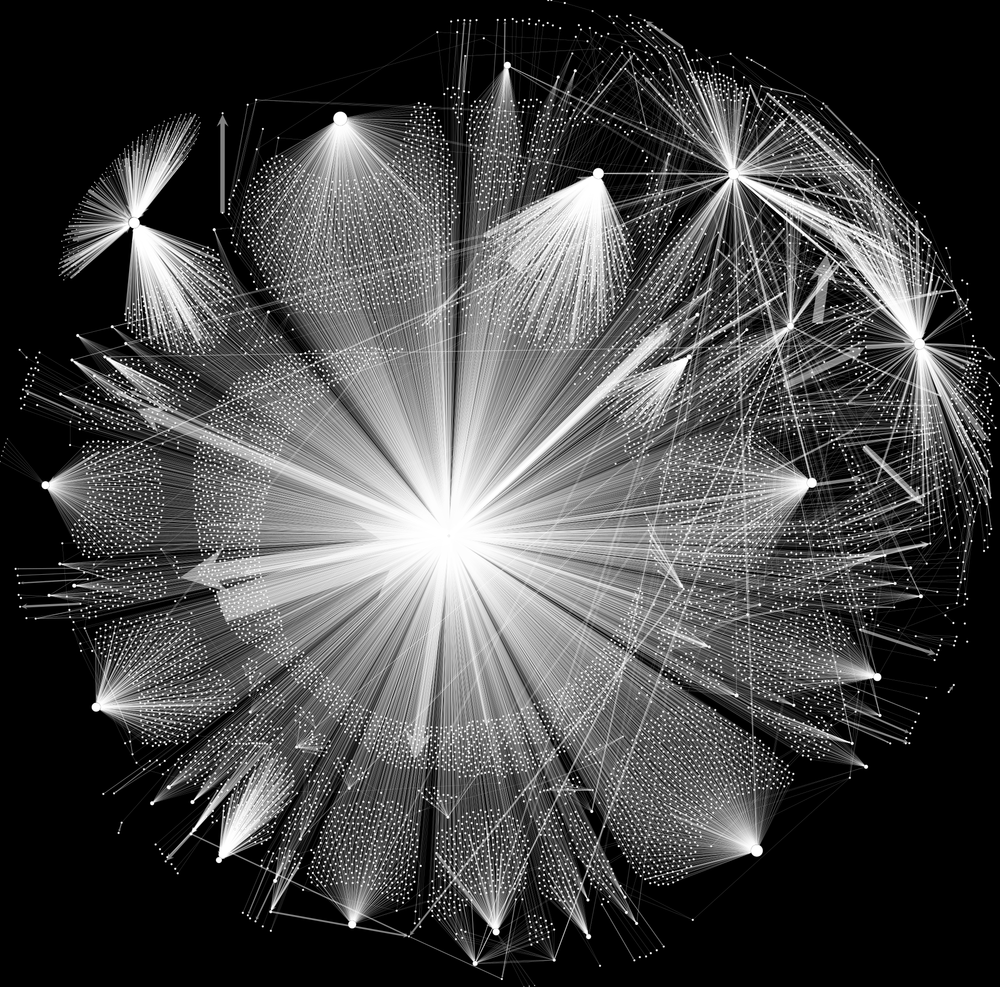

In [7]:
# Rendering hte medium graph
medium = convert_to_graph_tool_graph(medium_layout, medium_data)
draw(medium, size=1000, zoom=1)

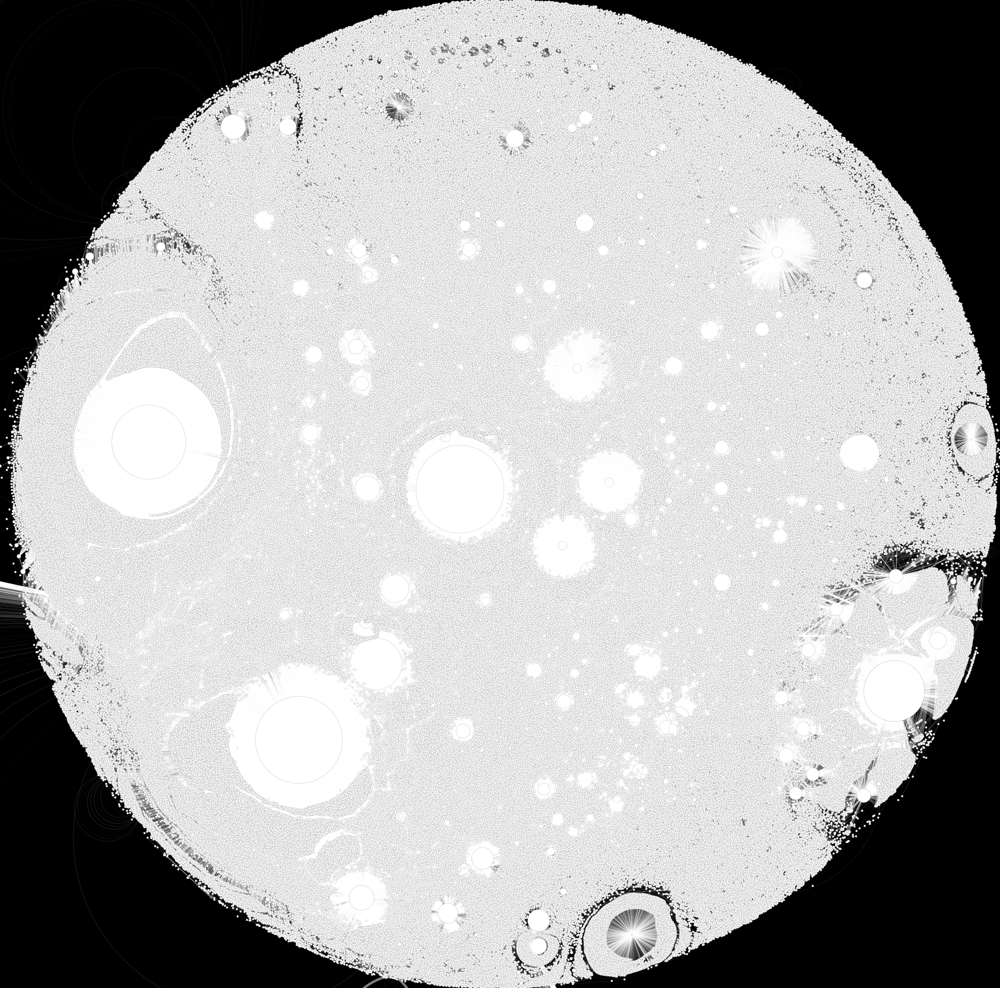

In [8]:
# Rendering the big graph
big = convert_to_graph_tool_graph(big_layout, big_data)
draw(big, size=1000, zoom=1)

### Try a sub-graph
Some edges (bottom and left) of the big graph are out of canvas.

Because there is a large difference between # of nodes between medium and large we try rendering sub-graphs of the big graph to see if it's an issue asscoiated with the number of nodes.

### Result
It works for 1/6 of the original number of nodes.
This experiemnt made it clear that what appears to be out of canvas are edges.

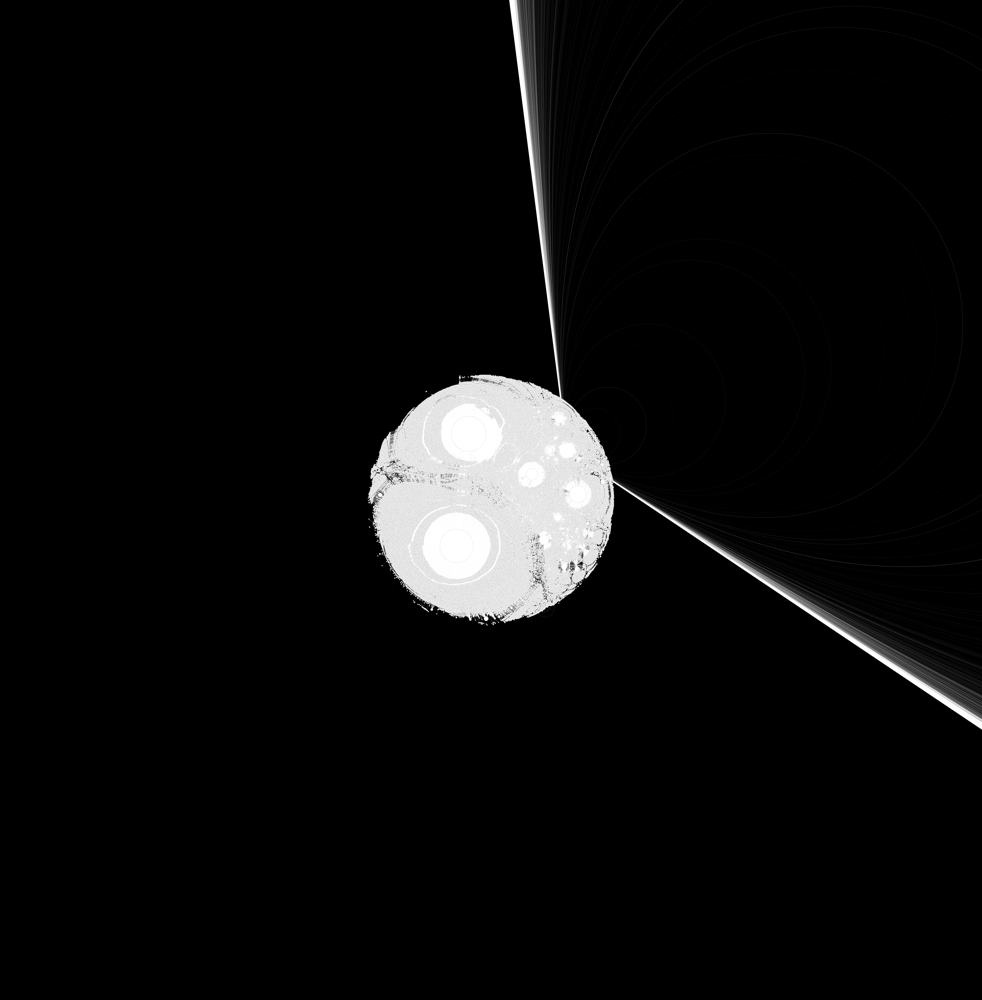

<Graph object, directed, with 131863 vertices and 316945 edges, at 0x7f21a6df6580>


In [9]:
# Uncomment one of the sizes

#n = len(big_data) // 6 # OK for 200.000 nodes
n = len(big_data) // 4 # for 300.000 nodes there are out of canvas nodes
# n = len(big_data) // 3 # for 400.000 nodes there are out of canvas nodes

medium_big_frame = make_gpu_frame(big_data.head(n))
medium_big_layout = make_cuGraph_layout(medium_big_frame)
medium_big = convert_to_graph_tool_graph(medium_big_layout, big_data.head(n))

draw(medium_big, size=2000, zoom=0.25)

### Try sparse graph with a few nodes
We generate a graph with 5 nodes. The positions are set to be the corners of the bounding rectangle of the graph.
This is to see if there are issues with nodes having coordinates far apart.

### Result
There are no issues with nodes coordinates.

{'center': (1.5158278, -12.26238), 'tl': (-1443.3729, 1411.7742), 'tr': (1422.2966, 1411.7742), 'bl': (-1443.3729, -1421.3395), 'br': (1422.2966, -1421.3395)}


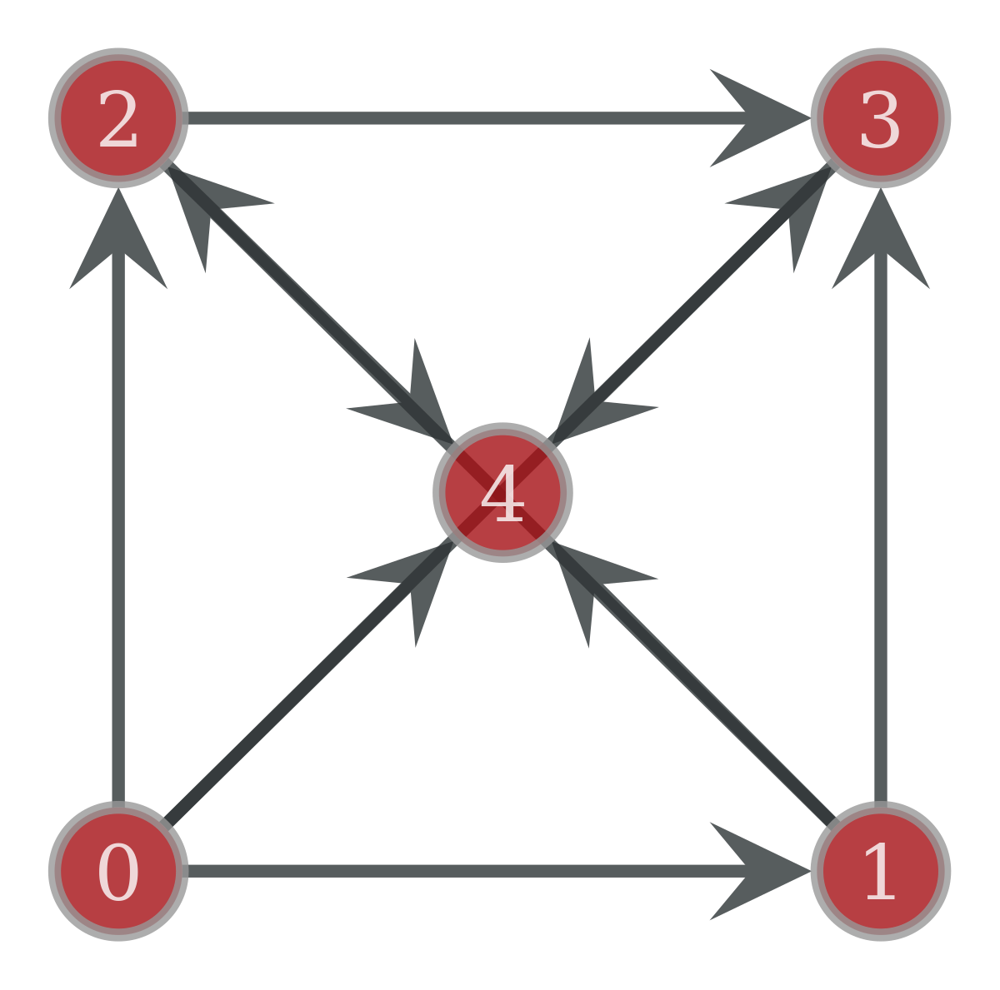

<VertexPropertyMap object with value type 'vector<double>', for Graph 0x7f20a69d6730, at 0x7f20a68ae250>

In [10]:
# given the interest points we generate a ficticious graph to test if having nodes far apart causes layout issues

# there are no issues, the problems with large nets layouts are most likely related to the sheer number of nodes.

int_points = get_interest_points(big_layout)
print(int_points)
g = Graph()

v1 = g.add_vertex()
v2 = g.add_vertex()
v3 = g.add_vertex()
v4= g.add_vertex()
v5 = g.add_vertex()

e = g.add_edge(v1, v2)
e = g.add_edge(v1, v3)
e = g.add_edge(v1, v4)
e = g.add_edge(v1, v5)

e = g.add_edge(v2, v3)
e = g.add_edge(v2, v4)
e = g.add_edge(v2, v5)

e = g.add_edge(v3, v4)
e = g.add_edge(v3, v5)

e = g.add_edge(v4, v5)

vprop_double = g.new_vertex_property("vector<double>")
vprop_double[0] = int_points['tl']
vprop_double[1] = int_points['tr']
vprop_double[2] = int_points['bl']
vprop_double[3] = int_points['br']
vprop_double[4] = int_points['center']

graph_draw(g, vertex_text=g.vertex_index, pos=vprop_double)

### Try graph_tool Force-directed graph drawing algo
Instead of cuGraph force atlas we tried graph_tool default layout algorithm.
Note that this implementationd oesn't use the GPU so it's a lot slower.
### Result
We have the same issues we had with cuGraph.
It renders correctly 1/6 of the big graph and has out-of-canvas stuff with more nodes.

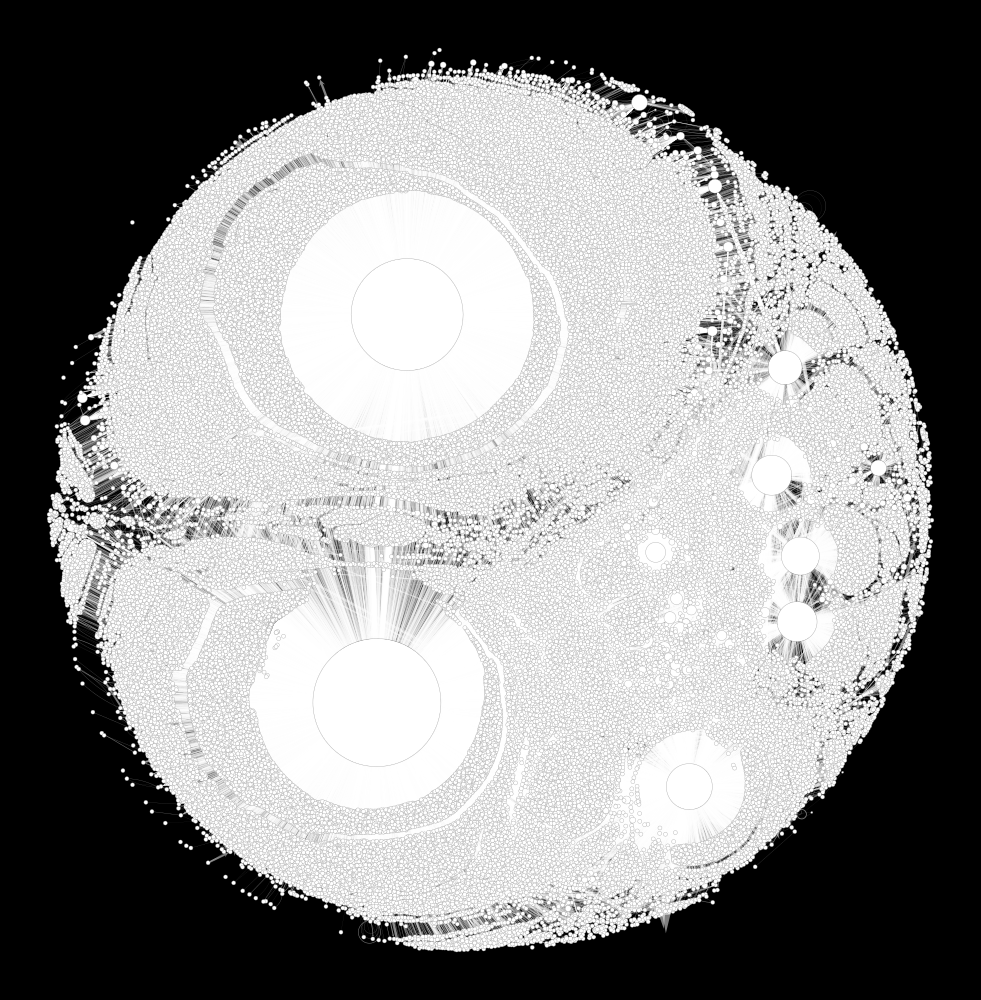

<VertexPropertyMap object with value type 'vector<double>', for Graph 0x7f516f7487f0, at 0x7f516fd8c190>

In [106]:
# Using graph_tool default layout algorithm on the fraction of the big graph

# It took arounbnd 30 minutes to draw the big graph with all the nodes (graph_tool does not use GPU)

# The result was again, out of canvas nodes.
# Running  graph_tool default layout algorithm priduced okay images if we took a sixth of the big network points.

g = medium_big
graph_draw(g['graph'],
           pos=g['pos'],
           bg_color=[0,0,0,1],
           vertex_size=g['deg'],
           vertex_fill_color=[1,1,1,1],
           edge_color=[1,1,1,0.5],
           edge_pen_width=g['esize'],
           #output="./img/test.png",
           output_size=[500, 500])

### Remove loop-edges
Maybe there arent any nodes out of canvas, what we see could just be self-edges.
We draw the graph after removing all but one the loop-edges of each node.
### Result
Indeed, now the graph has everything on canvas.

11396
[(<Vertex object with index '1167' at 0x7f479c1f2ac0>, <Vertex object with index '1167' at 0x7f479c1f2a50>), (<Vertex object with index '1865' at 0x7f478220e900>, <Vertex object with index '1865' at 0x7f478220eeb0>), (<Vertex object with index '157702' at 0x7f4782346740>, <Vertex object with index '157702' at 0x7f47823466d0>), (<Vertex object with index '340238' at 0x7f479c207660>, <Vertex object with index '340238' at 0x7f479c2075f0>), (<Vertex object with index '92355' at 0x7f4782361f90>, <Vertex object with index '92355' at 0x7f4782376040>), (<Vertex object with index '97193' at 0x7f4782376660>, <Vertex object with index '97193' at 0x7f47823765f0>), (<Vertex object with index '209926' at 0x7f478236e740>, <Vertex object with index '209926' at 0x7f478236e6d0>), (<Vertex object with index '214929' at 0x7f478236eac0>, <Vertex object with index '214929' at 0x7f478236ea50>), (<Vertex object with index '43465' at 0x7f478234c4a0>, <Vertex object with index '43465' at 0x7f478234c430>),

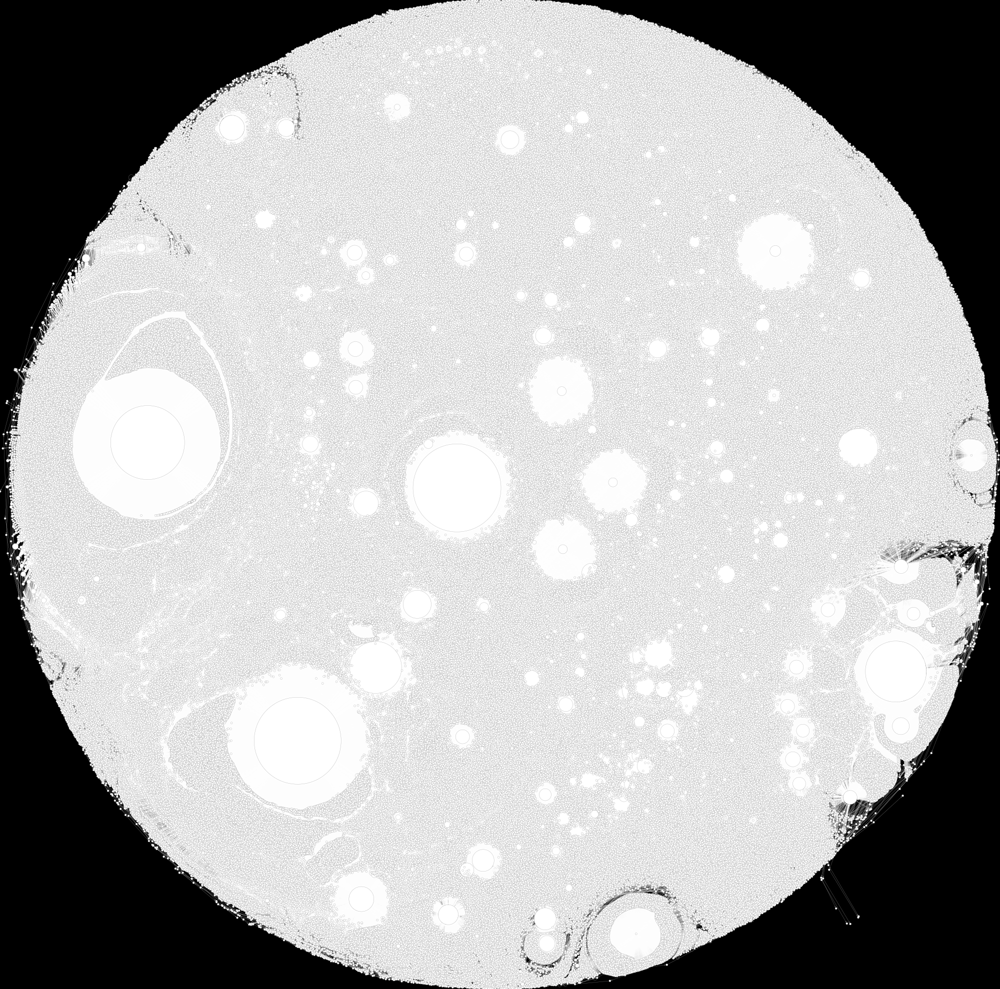

<VertexPropertyMap object with value type 'vector<double>', for Graph 0x7f478a0682e0, at 0x7f478a068040>

In [8]:
b = convert_to_graph_tool_graph(big_layout, big_data)

no_loops_graph = b['graph']
no_loops_graph.set_fast_edge_removal(True)

self_edges = []
keep_one = set([])

# iterate loop-edges
for e in no_loops_graph.edges():
    if e.source() == e.target():
        keep_one.add((e.source(), e.target())) # a set so each loop.edges will appear once
        self_edges.append(e)

# remove all loop.edges
for e in self_edges:
    no_loops_graph.remove_edge(e)

# reintroduce loop-edges, once for each node
for e in list(keep_one):
    no_loops_graph.add_edge(e[0], e[1])
    
graph_draw(no_loops_graph,
           pos=b['pos'],
           bg_color=[0,0,0,1],
           vertex_size=b['deg'],
           vertex_fill_color=[1,1,1,1],
           edge_color=[1,1,1,0.5],
           #output="./img/test.png",
           output_size=[1000, 1000],
           fit_view=1)   

11396
[(<Vertex object with index '1167' at 0x7f479c1f2ac0>, <Vertex object with index '1167' at 0x7f479c1f2a50>), (<Vertex object with index '1865' at 0x7f478220e900>, <Vertex object with index '1865' at 0x7f478220eeb0>), (<Vertex object with index '157702' at 0x7f4782346740>, <Vertex object with index '157702' at 0x7f47823466d0>), (<Vertex object with index '340238' at 0x7f479c207660>, <Vertex object with index '340238' at 0x7f479c2075f0>), (<Vertex object with index '92355' at 0x7f4782361f90>, <Vertex object with index '92355' at 0x7f4782376040>), (<Vertex object with index '97193' at 0x7f4782376660>, <Vertex object with index '97193' at 0x7f47823765f0>), (<Vertex object with index '209926' at 0x7f478236e740>, <Vertex object with index '209926' at 0x7f478236e6d0>), (<Vertex object with index '214929' at 0x7f478236eac0>, <Vertex object with index '214929' at 0x7f478236ea50>), (<Vertex object with index '43465' at 0x7f478234c4a0>, <Vertex object with index '43465' at 0x7f478234c430>),

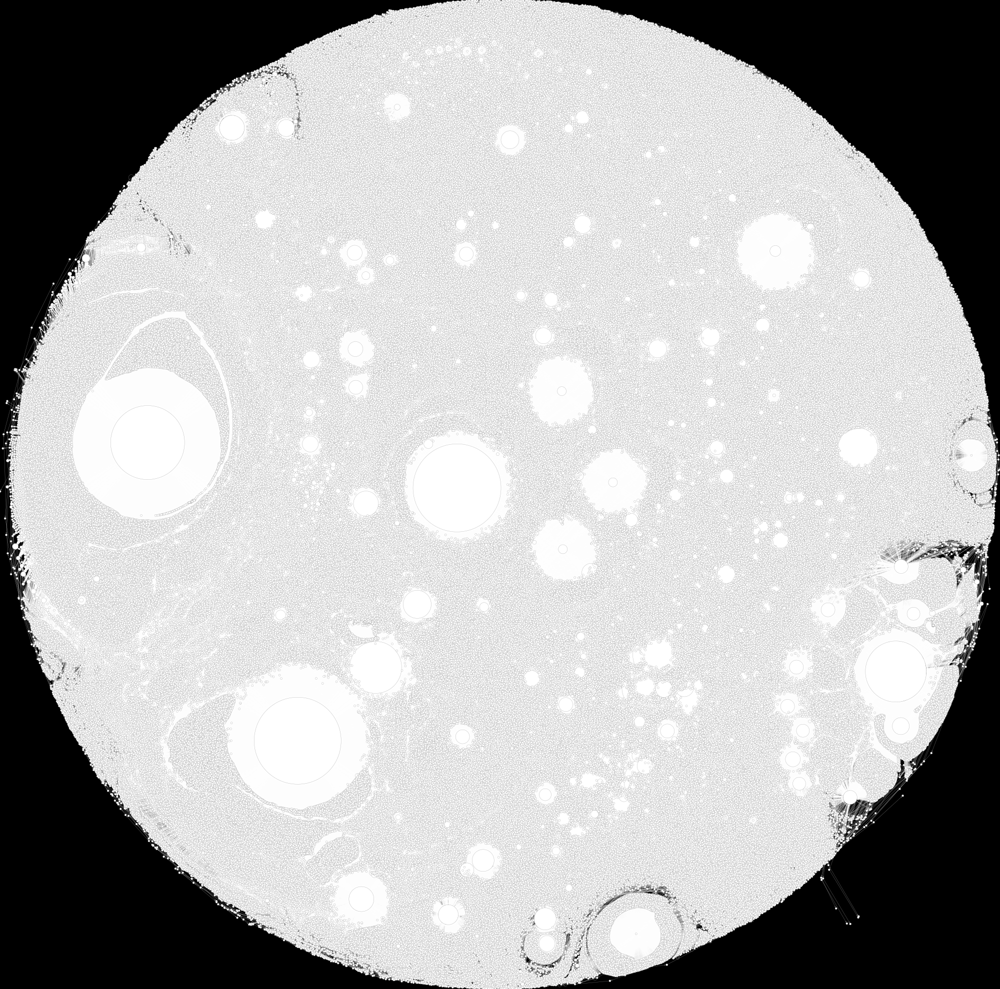

<VertexPropertyMap object with value type 'vector<double>', for Graph 0x7f478a0682e0, at 0x7f478a068040>

In [8]:
b = convert_to_graph_tool_graph(big_layout, big_data)

g = b['graph']
g.set_fast_edge_removal(True)

self_edges = []
keep_one = set([])

# iterate loop-edges
for e in g.edges():
    if e.source() == e.target():
        keep_one.add((e.source(), e.target())) # a set so each loop.edges will appear once
        self_edges.append(e)

# remove all loop.edges
for e in self_edges:
    g.remove_edge(e)

# reintroduce loop-edges, once for each node
for e in list(keep_one):
    g.add_edge(e[0], e[1])
    
graph_draw(g,
           pos=b['pos'],
           bg_color=[0,0,0,1],
           vertex_size=b['deg'],
           vertex_fill_color=[1,1,1,1],
           edge_color=[1,1,1,0.5],
           #output="./img/test.png",
           output_size=[1000, 1000],
           fit_view=1)   

### Graph_tool stress test
We generate a fictitious grid-like graph with tons of nodes and we try render it.

### Result
For a directed graph, with 1.000.000 vertices and 4.000.000 edges it worked.
Took about 30 mins

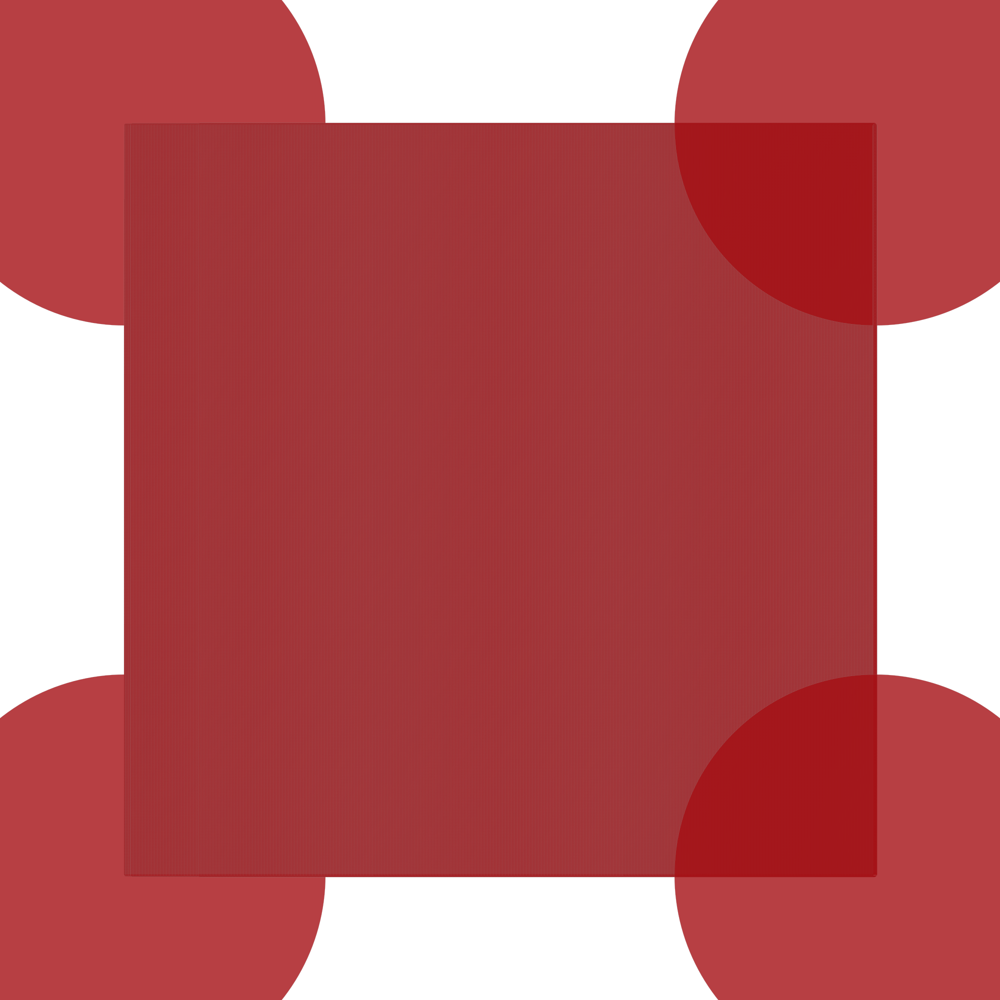

<Graph object, directed, with 508083 vertices and 1256788 edges, at 0x7f478a0682e0>


In [13]:
# Test the limit of graph_tool

# Given a (side * side) grid, fill it with (side * side) nodes
# Connect somne nodes with all the others
# Draw

# Without node degree, i.e. all nodes same size


side = 1000
grid_graph = Graph()
verteces = []
edges = []

gg_vprop_double = grid_graph.new_vertex_property("vector<double>")

# geenrate nodes
for x in range(0, side):
    for y in range(0, side):
        v = grid_graph.add_vertex()
        verteces.append(v)
        #print(side * x + y)
        gg_vprop_double[side * x + y] = (x, y)
        
# add some edges
for v in verteces:
    grid_graph.add_edge(verteces[0], v)
    grid_graph.add_edge(verteces[side - 1], v)
    grid_graph.add_edge(verteces[side * side - 1], v)
    grid_graph.add_edge(verteces[side * side - side], v)

deg = grid_graph.degree_property_map("out")
deg.a = 4 * (np.sqrt(deg.a) * 0.1 + 0.4)


graph_draw(grid_graph, 
           vertex_text=grid_graph.vertex_index,
           vertex_size=deg,
           pos=gg_vprop_double,
            output_size=[1000, 1000],
           fit_view=0.75) 

print(g)

### Experiment fit_view
Can we use fit_view as a tuple (x, y, h, w) to effectivelly zoom into sections of the graph?

### Result
Yes it works, maybe it's visually messy.
The less h and w are the more zoomed it will be.

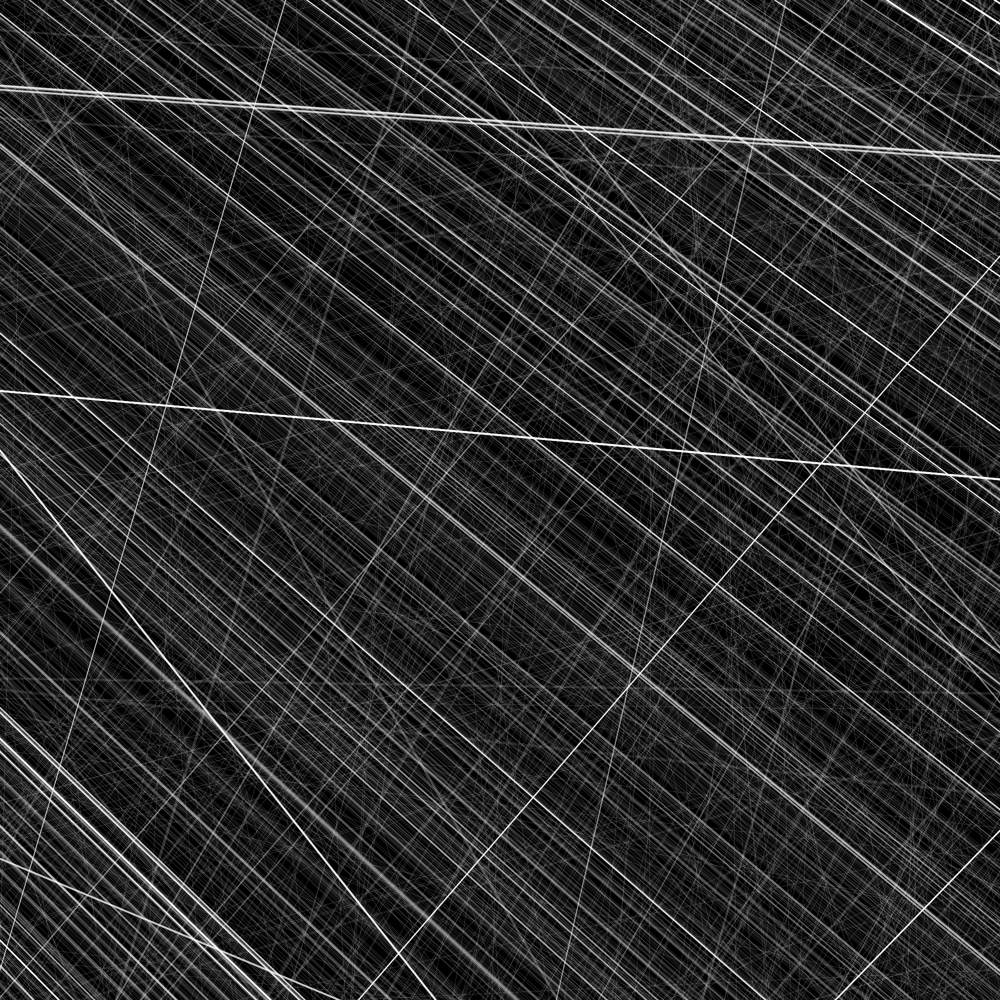

<VertexPropertyMap object with value type 'vector<double>', for Graph 0x7f478a0682e0, at 0x7f478a068040>

In [11]:
graph_draw(g,
           pos=b['pos'],
           bg_color=[0,0,0,1],
           vertex_size=b['deg'],
           vertex_fill_color=[1,1,1,1],
           edge_color=[1,1,1,0.5],
           #output="./img/test.png",
           output_size=[1000, 1000],
           fit_view=(-45, 45, 20, 20))    

In [ ]:
graph_draw(grid_graph,
           pos=gg_vprop_double,
           bg_color=[0,0,0,1],
           vertex_size=deg,
           vertex_fill_color=[1,1,1,1],
           edge_color=[1,1,1,0.5],
           #output="./img/test.png",
           output_size=[1000, 1000],
           fit_view=(0, 0, 20, 20)) 

### cuGraph force atlas 2 random grid search
This is pointless: the problem is graph tool, not cuGraph force atlas algo - included just for reference and maybe future use.

In [ ]:
# Force Atlas Grid Search 

# Radom grid search on the cugraph force atlas parameters to check if there is a combination of parameters that produce a layout with no 
# out of canvas nodes

# All images had the same issue.

parameters_to_values = {
    'max_iter':[10, 25, 50, 75, 100],
    'strong_gravity_mode': [True, False],
    'barnes_hut_optimize': [True, False],
    'barnes_hut_theta': np.arange(0.1, 1.3, 0.1),
    'outbound_attraction_distribution': [True, False],
    'jitter_tolerance': [0.1, 0.25, 0.5, 0.75, 0.999],
    'lin_log_mode': [True, False],
    'scaling_ratio': [0.1, 0.5, 0.9, 1.3, 1.5, 1.7, 2, 2.5, 3, 3.5],
    'gravity': [0.5, 1.0, 1.5, 3.0, 5.0, 7.0, 10.0, 12.0, 15.0, 17.0, 20.0]
    
    
}
random.seed(85)
grid = []
for i in range(0, 800, 1):
    selection = []
    for k in parameters_to_values:
        random_choice = random.choice(parameters_to_values[k])
        selection.append(random_choice)

    if tuple(selection) not in grid:
        grid.append(tuple(selection))
print(len(grid))    

for combo in grid:
    print(combo)
    layout = cugraph.layout.force_atlas2(G, max_iter=combo[0],
                                         strong_gravity_mode=combo[1],
                                         barnes_hut_optimize=combo[2],
                                         barnes_hut_theta=combo[3],
                                         outbound_attraction_distribution=combo[4],
                                         jitter_tolerance=combo[5],
                                         lin_log_mode=combo[6],
                                         scaling_ratio=combo[7], 
                                         gravity=combo[8])
    layout = layout.to_pandas()
    #print(layout.head())
    # plotting with graph-tool

    # experiments: size 5000 x 5000 takes: 900 seconds

    start_time = int(round(time.time()))

    g = Graph(directed=True)

    # take the layout from cugraph and convert it to a graph-tool vertex property
    vprop_double = g.new_vertex_property("vector<double>")
    for i, row in enumerate(layout.sort_values("vertex")[["x", "y"]].values):
        vprop_double[i] = row

    eweight = g.new_edge_property("string")
    g.add_edge_list(data[["source", "target", "amount"]].values, hashed=True, eprops=[eweight])

    # create an edge property representing edge width
    esize = g.new_edge_property("float")
    esize.a = list(map(lambda x: float(x), list(eweight)))
    esize.a = (esize.a / (esize.a.max() / 1000.0))
    esize.a = np.sqrt(esize.a)

    # create a degree map for different vertex sizes based on vertex degree
    deg = g.degree_property_map("in")
    deg.a = 4 * (np.sqrt(deg.a) * 0.1 + 0.4)
    
    fiel_name =  "max_iter={}, strong_gravity_mode={}, barnes_hut_optimize={}, barnes_hut_theta={:.2f}, outbound_attraction_distribution={}, jitter_tolerance={:.2f}, lin_log_mode={}, scaling_ratio={:.2f}, gravity={:.2f}".format(combo[0], combo[1], combo[2], combo[3], combo[4], combo[5],combo[6],combo[7],combo[8])
    final = "./mediumGridExperiments/" + fiel_name + ".png"
    #print(final)             
        
    graph_draw(g, pos=vprop_double,
               bg_color=[0,0,0,1],
               vertex_size=deg,
               vertex_fill_color=[1,1,1,1],
               edge_color=[1,1,1,0.5],
               edge_pen_width=esize,
               output= final,
               output_size=[500, 500])

    #print("It took {0} seconds".format(int(round(time.time())) - start_time))